In [2]:
from IPython.display import Image
import matplotlib.pyplot as plt

# [Albumentations](https://github.com/albumentations-team/albumentations#pixel-level-transforms)

In [2]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import cv2

# Трансформации без изменения положения

# [AdditiveNoise](https://explore.albumentations.ai/transform/AdditiveNoise)

Добавляет к каждому пикселю случайное значение шума в соответствии с выбранным распределением.

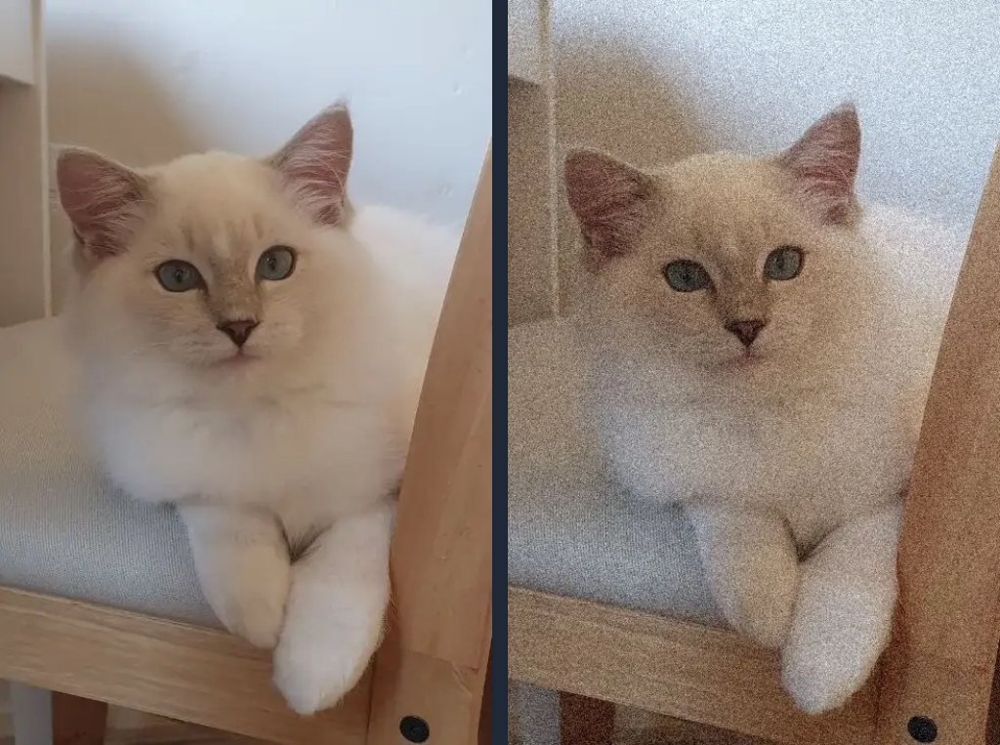

In [3]:
Image("datasets/images/AdditiveNoise.png", width="60%")

**class [AdditiveNoise](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20AdditiveNoise) (noise_type = 'uniform', spatial_mode = 'constant', noise_params = None, approximation = 1.0, p = 0.5)**

**noise_type** - распределение, которое будет использоваться для генерации шума. **('uniform', 'gaussian', 'laplace', 'beta')**

**spatial_mode** - параметр, который задаёт, как распределяется шум по изображению.

- **constant** - один шумовой коэффициент генерируется на канал и применяется ко всему изображению одинаково. Самый быстрый. $\newline$

- **shared** - создаётся одно общее шумовое изображение, которое применяется ко всем каналам одновременно. Для одного пикселя (независимо от канала) одно и то же значение шума.$\newline$

- **per_pixel** - для каждого пикселя и канала генерируется собственное случайное значение шума. Максимально случайный.

**approximation** - определяет компромисс между качеством сгенерированного шума и скоростью его генерации. Значения принимает в диапазоне [0, 1]. Например, для значения 0.5: шум генерируется в разрешении, уменьшенном в два раза (то есть половина исходного), а затем масштабируется обратно до полного разрешения изображения.

**noise_params** - задаются конкретные настройки распределения шума. Например, для **noise_type = 'uniform'** **{ranges: [(-0.1, 0.1), (-0.2, 0.2), (-0.1, 0.1)]}** (для красного, зелёного и синего каналов будут заданы разные диапазоны). Для **noise_type = 'gaussian'**: **{"mean_range": [0, 0], "std_range": [0.1, 0.15]}** (случайно выбираются значения из диапазона).

**p** - вероятность применения трансформации.

# [ISONoise](https://explore.albumentations.ai/transform/ISONoise)

Имитирует шум, характерный для изображений, снятых на камеру при высоких значениях **ISO**. 

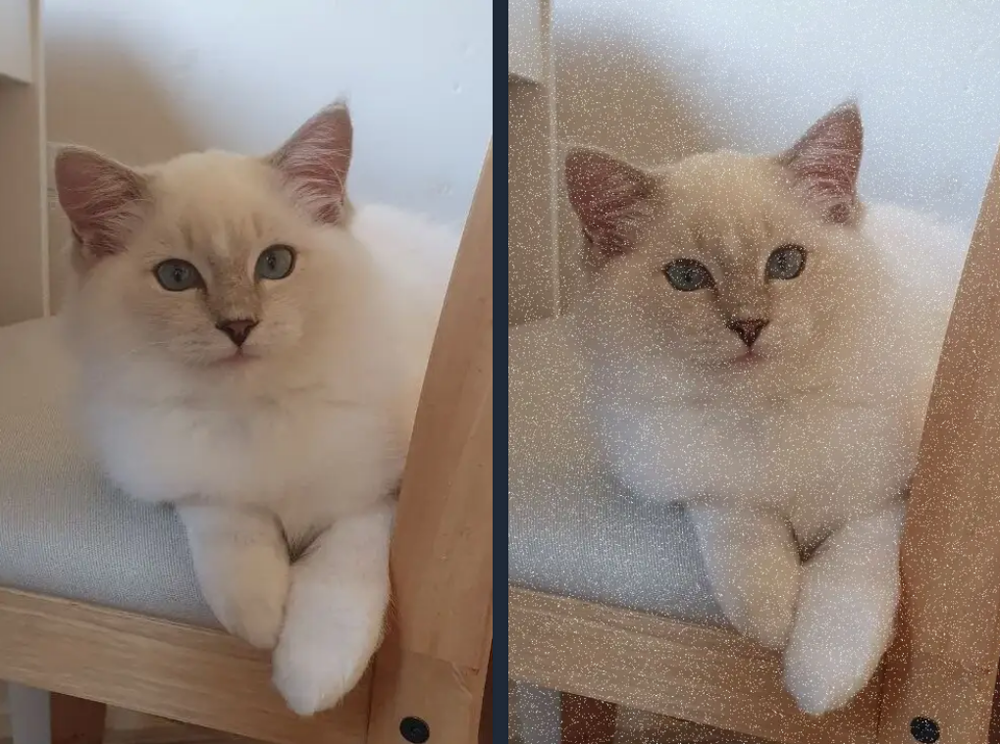

In [6]:
Image("datasets/images/ISONoise.png", width="60%")

**class [ISONoise](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ISONoise) (color_shift = (0.01, 0.05), intensity = (0.1, 0.5), p = 0.5)**

**color_shift** - диапазон изменения оттенка цвета. Диапазон значений: $[0, 1]$.

**intensity** - определяет интенсивность добавляемого шума как по яркости, так и по цвету. Чем выше значение, тем больше точек.

**p** - вероятность применения трансформации.

# [MultiplicativeNoise](https://explore.albumentations.ai/transform/MultiplicativeNoise)

Умножает каждый пиксель изображения на случайное значение, взятое из некого диапазона.

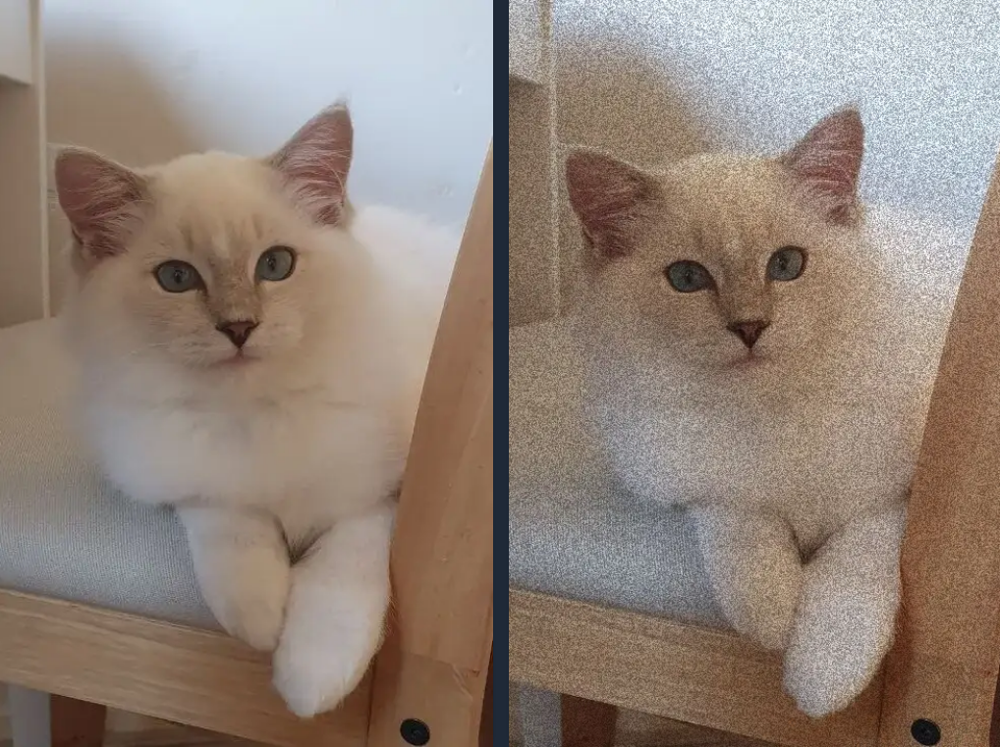

In [5]:
Image("datasets/images/MultiplicativeNoise.png", width="60%")

**class [MultiplicativeNoise](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20MultiplicativeNoise) (multiplier = (0.9, 1.1), per_channel = False, elementwise = False, p = 0.5)**

**multiplier** - определяет диапазон, из которого выбирается множитель.

**per_channel** - если **True**, использовать другие случайные множители для каждого канала. Если **False**, использовать один и тот же набор множителей для всех каналов.

**elementwise** - если **True**, генерирует уникальный множитель для каждого пикселя. Если **False**, генерирует один множитель для каждого пикселя.

**p** - вероятность применения трансформации.

# [CLAHE](https://explore.albumentations.ai/transform/CLAHE)

Метод улучшения контрастности изображения. Происходит как бы «растягивание» яркости всех пикселей так, чтобы самые тёмные стали ближе к чёрному, а самые светлые — к белому, но применяется это не ко всему изображению сразу, а только к небольшим областям (плиткам) изображения. Этот метод предотвращает чрезмерное усиление контрастности в областях с изначально низким контрастом.

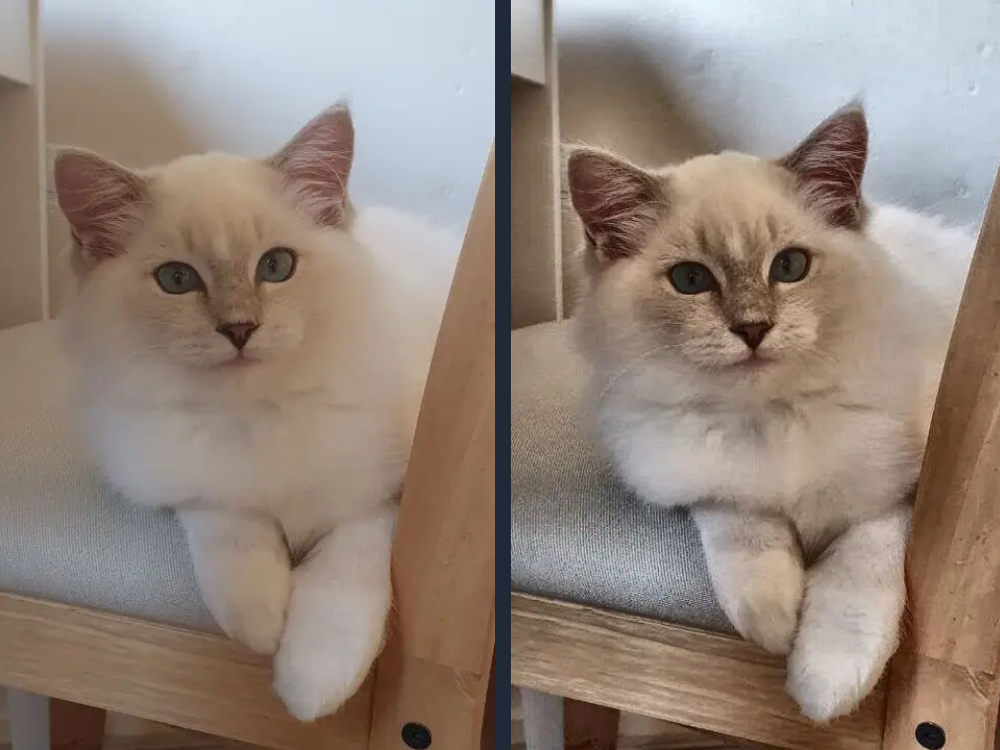

In [7]:
Image("datasets/images/CLAHE.png", width="60%")

**class [CLAHE](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20CLAHE) (clip_limit = 4.0, tile_grid_size = (8, 8), p = 0.5)**

**clip_limit** - контролирует, насколько сильно можно усиливать контраст. Если передать кортеж, например, **(1.0, 4.0)**, то при каждом применении будет случайно выбираться значение из этого диапазона. 

**tile_grid_size** - определяет количество плиток в направлениях строк и столбцов. Меньшие размеры плиток могут привести к более локализованным улучшениям, в то время как большие размеры дают результаты, более близкие к глобальному выравниванию гистограммы. 

**p** - вероятность применения трансформации.

# [Blur](https://explore.albumentations.ai/transform/Blur)

Добавляет равномерное размытие к изображению. 

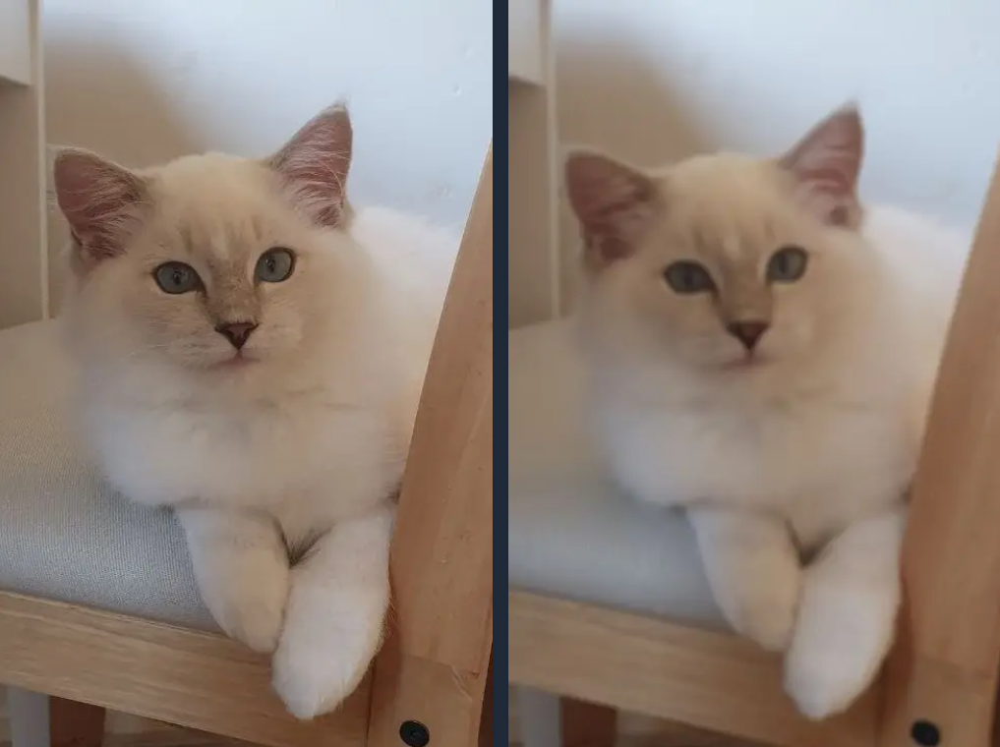

In [9]:
Image("datasets/images/Blur.png", width="60%")

**class Blur (blur_limit, p)**

**blur_limit** - определяет диапазон размеров ядра размытия. Значения - нечетные числа. Например, blur_limit = (3, 7).

**p** - вероятность применения трансформации.

# [GlassBlur](https://explore.albumentations.ai/transform/GlassBlur)

Создает эффект, похожий на размытость и искажения, возникающие при просмотре изображения через неровное стекло. Как работает: Некоторые пиксели перемещаются в пределах небольшой области, что имитирует неравномерность поверхности стекла. После этого применяется размытие (обычно гауссовское), чтобы сгладить резкие переходы и усилить ощущение «разбитости» или стеклянного эффекта.

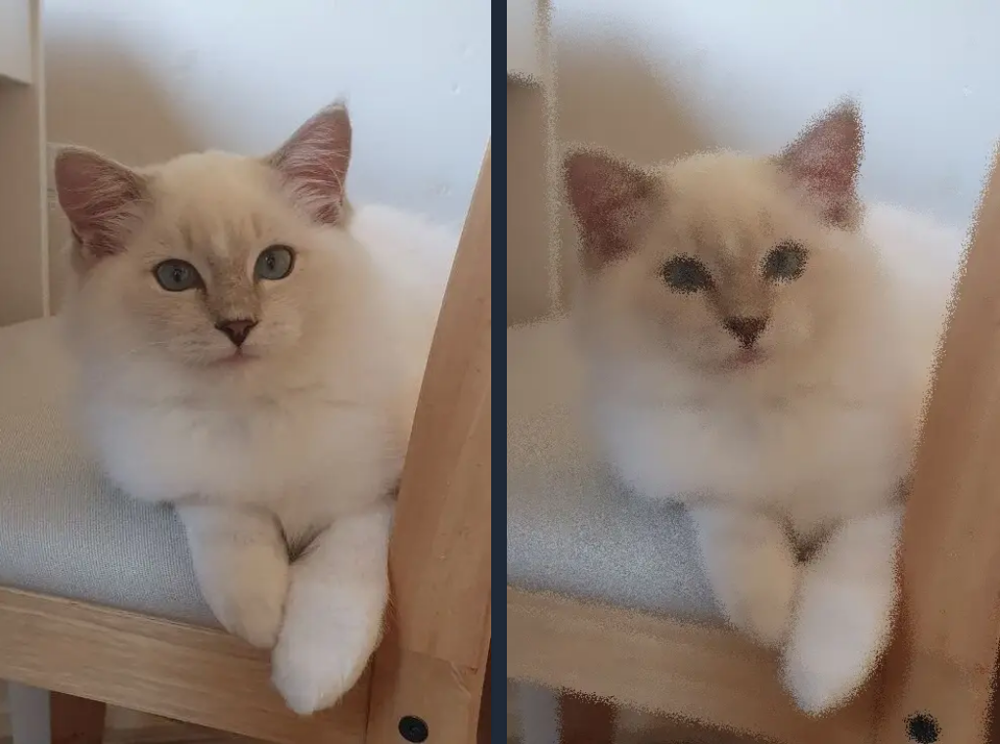

In [11]:
Image("datasets/images/GlassBlur.png", width="60%")

**class GlassBlur (sigma, max_delta, iterations)**

**sigma** - cтандартное отклонение для гауссова размытия, которое определяет, насколько сильно будет размыто изображение.

**max_delta** - максимальное смещение для случайного перемещения пикселей, то есть насколько далеко пиксель может «отойти» от исходного положения.

**iterations** - количество итераций перемешивания, что влияет на итоговую интенсивность искажения.

**p** - вероятность применения трансформации.

# [MotionBlur](https://explore.albumentations.ai/transform/MotionBlur)

Имитирует размытие, вызванное движением камеры или объекта во время съёмки.

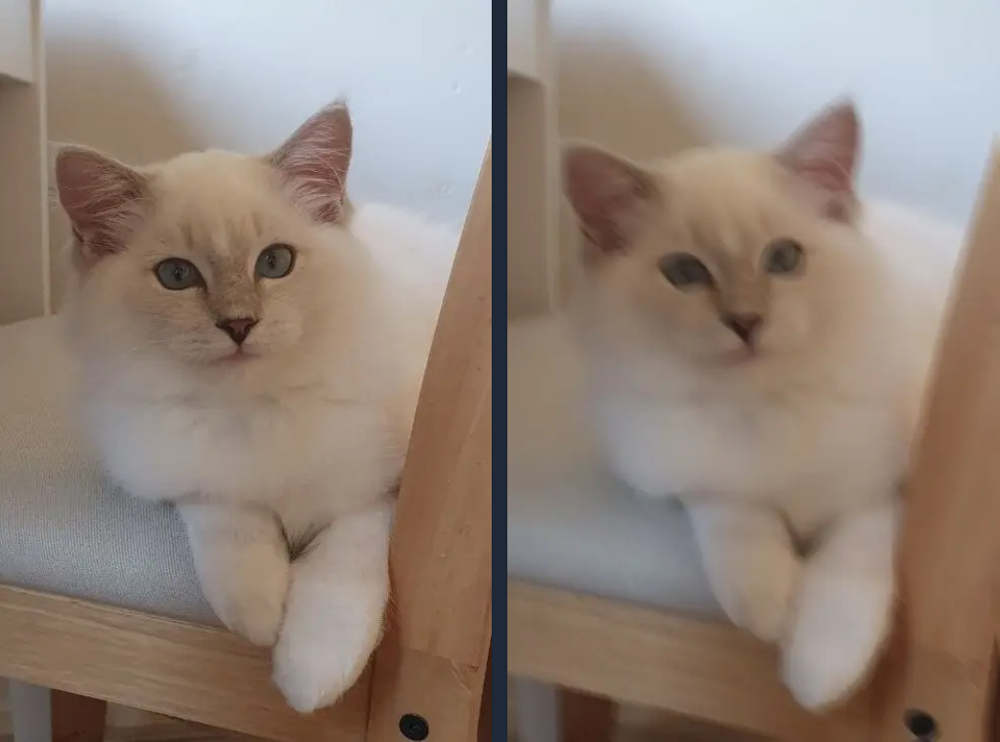

In [12]:
Image("datasets/images/MotionBlur.png", width="60%")

**class MotionBlur (blur_limit = (3, 7), allow_shifted = True, angle_range = (0.0, 360.0), direction_range = (-1.0, 1.0), p = 0.5)**

**blur_limit** - определяет диапазон размеров ядра размытия. Значения - нечетные числа. Например, blur_limit = (3, 7).

**allow_shifted** - размытие применяется со случайным сдвигом, что делает эффект более естественным.

**angle_range** - задаёт диапазон углов (в градусах). Управляет поворотом линии размытия в движении. Например, 90° - размытие вертикального движения.

**direction_range** - управляет тем, в какую сторону распространяется эффект размытия относительно направления движения. -1 - размытие распространяется только в "обратном" направлении (за движущимся объектом). 0 - размытие симметрично относительно центра, то есть эффект распространяется одинаково в обоих направлениях. 1 - размытие распространяется только в "прямом" направлении.

**p** - вероятность применения трансформации.

# [MedianBlur](https://explore.albumentations.ai/transform/MedianBlur)

Реализует медианный фильтр для размытия изображения (для каждого пикселя выбирается значение медианы из окрестности). 

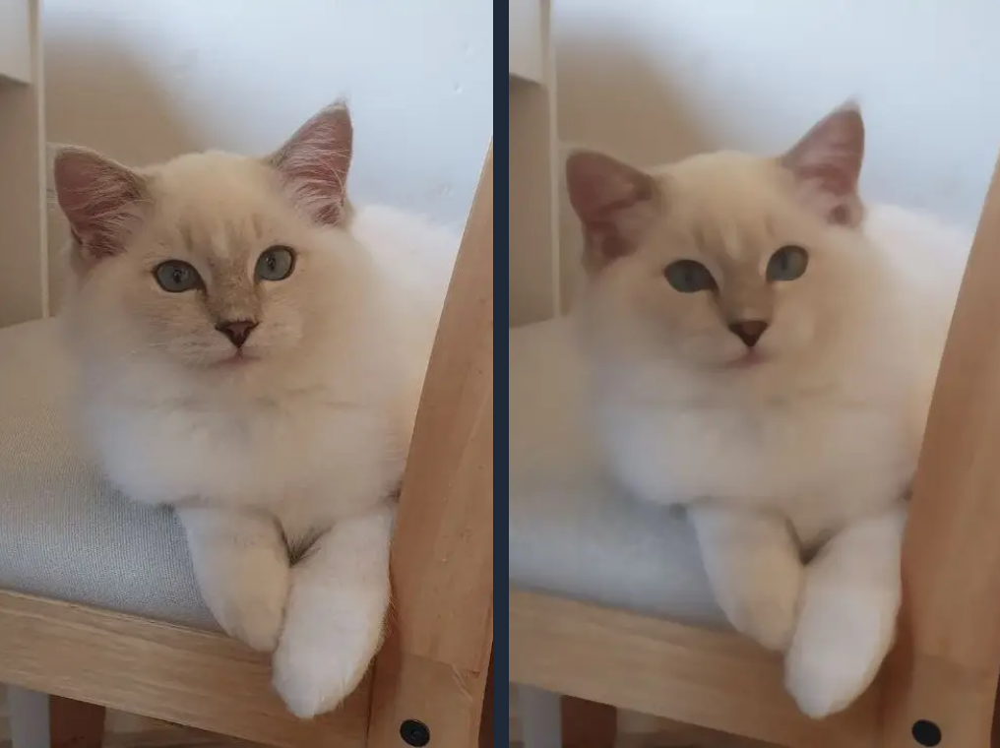

In [14]:
Image("datasets/images/MedianBlur.png", width="60%")

**class MedianBlur (blur_limit, p)**

**blur_limit** - определяет диапазон размеров ядра размытия. Значения - нечетные числа. Например, blur_limit = (3, 7)

**p** - вероятность применения трансформации.

# [ColorJitter](https://explore.albumentations.ai/transform/ColorJitter)

Случайным образом изменяет яркость, контрастность, насыщенность и оттенок изображения.

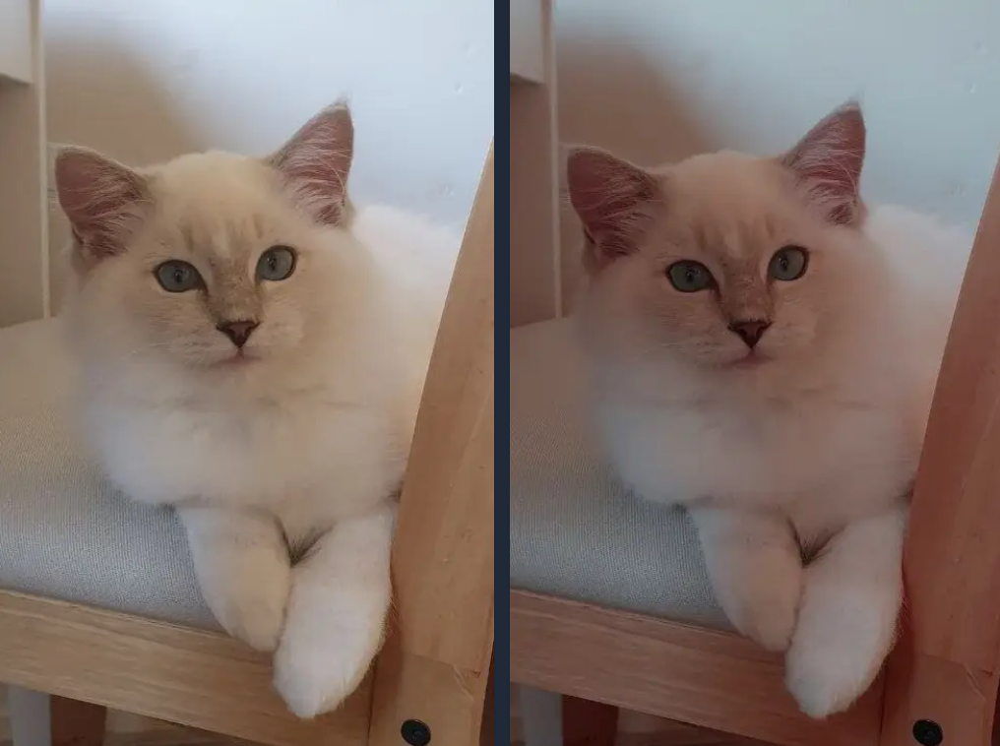

In [15]:
Image("datasets/images/ColorJitter.png", width="60%")

**class [ColorJitter](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ColorJitter) (brightness = (0.8, 1.2), contrast = (0.8, 1.2), saturation = (0.8, 1.2), hue = (-0.5, 0.5), p = 0.5)**

**brightness** - яркость: делает изображение темнее или светлее. $(0.8, 1.2) → \pm\,20\%$

**contrast** - контраст: увеличивает/уменьшает разницу между тёмными и светлыми участками. $(0.7, 1.3) → ±\,30\%$

**saturation** - насыщенность: изменяет интенсивность цветов. $(0.5, 1.5) → ±\,50\%$

**hue** - оттенок: смещает цвета по спектру (например, зелёный → бирюзовый). Диапазон значений: $0 ≤ hue ≤ 0.5$ если значение - **float**. Если кортеж - диапазон $[-0.5, 0.5]$.

**p** - вероятность применения трансформации.

# [HueSaturationValue](https://explore.albumentations.ai/transform/HueSaturationValue)

Изменяет цвета изображения в пространстве **HSV** (оттенок, насыщенность, яркость). Причем все они (оттенок, насыщенность, яркость) меняются независимо, так как эта трансформация работает в формате **HSV**, а не **RGB**. Например, **ColorJitter** при увеличении яркости может неявно изменить насыщенность. **HueSaturationValue** не меняет контрастность.

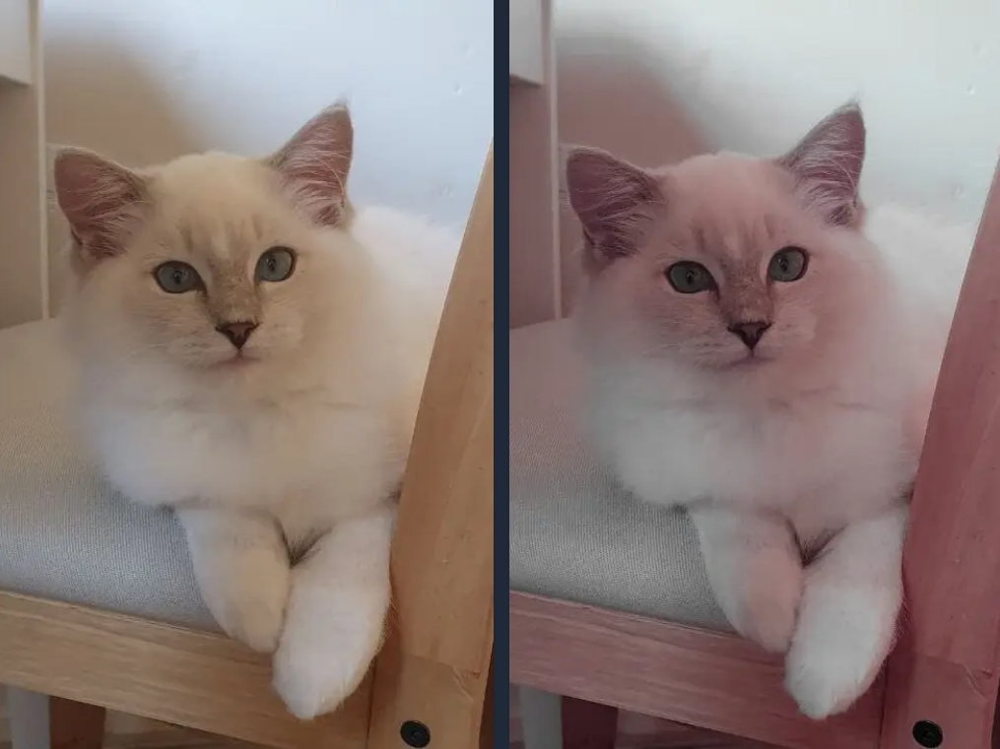

In [16]:
Image("datasets/images/HueSaturationValue.png", width="60%")

**class [HueSaturationValue](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20HueSaturationValue) (hue_shift_limit = (-20, 20), sat_shift_limit = (-30, 30), val_shift_limit = (-20, 20), p = 0.5)**

**hue_shift_limit** - диапазон изменения оттенка. Диапазон значений: $[-180, 180]$.

**sat_shift_limit** - диапазон изменения насыщенности. Диапазон значений: $[-255, 255]$.

**val_shift_limit** - диапазон изменения значения яркости. Диапазон значений: $[-255, 255]$.

**p** - вероятность применения трансформации.

# [PlanckianJitter](https://explore.albumentations.ai/transform/PlanckianJitter)

Изменяет цветовую температуру изображения, имитируя естественные изменения освещения в зависимости от физики излучения. Трансформация не просто случайно меняет цвета, а делает это на основе реальных законов (например, закона Планка), чтобы изображение выглядело так, как если бы его снимали при разных типах света — от теплого закатного до холодного дневного. В отличие от **ColorJitter**, который случайным образом изменяет яркость, контраст и насыщенность, **PlanckianJitter** использует реальные физические зависимости изменения цвета при изменении источника света.

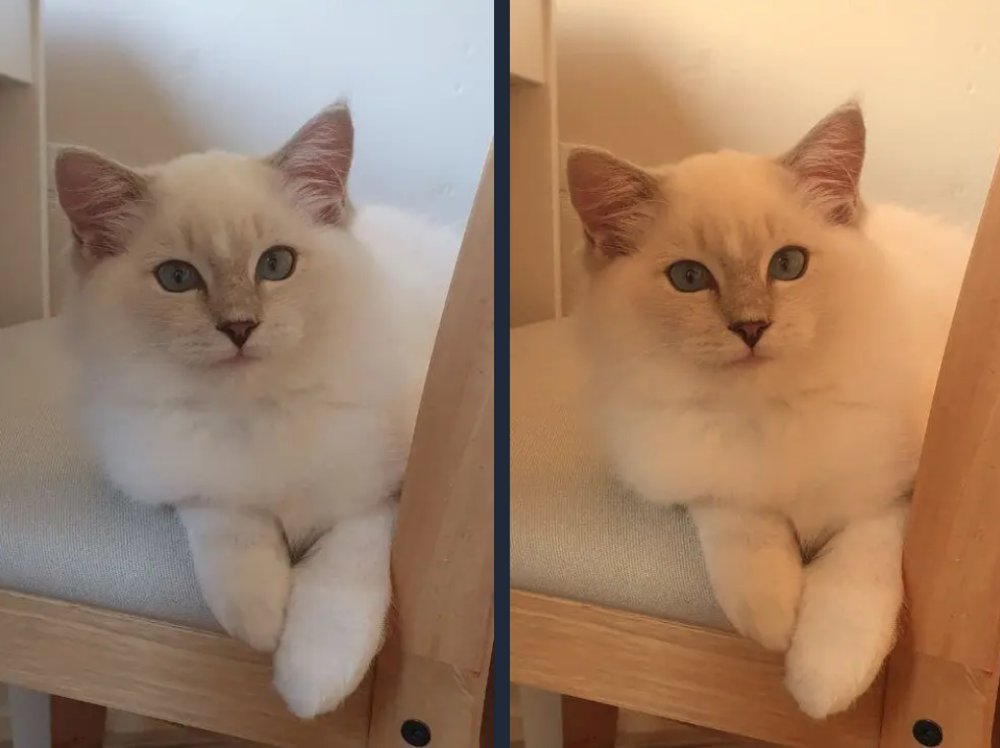

In [17]:
Image("datasets/images/PlanckianJitter.png", width="60%")

**class [PlanckianJitter](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20PlanckianJitter) (mode = 'blackbody', temperature_limit = None, sampling_method = 'uniform', p = 0.5)**

**mode** - выбирает физическую модель, на основе которой происходит изменение цветовой температуры изображения.

- **blackbody** - используется модель излучения черного тела (по закону Планка). $\newline$

- **cied** - модель, основанная на стандартах дневного света (CIE D illuminants). 

**temperature_limit** - определяет диапазон температур, из которого выбирается значение для изменения цвета. Более высокие температуры дают более холодные (голубоватые) изображения, более низкие температуры дают более теплые (красноватые) изображения. Диапазон значении для **blackbody** - $[3000, 15000]$, для **cied** - $[4000, 15000]$.

**sampling_method** - определяет способ выбора температуры из заданного диапазона.

- **uniform** - температура выбирается из равномерного распределения. $\newline$

- **gaussian** - выборка из гауссовского распределения с центром в 6500K (приблизительно дневной свет).

**p** - вероятность применения трансформации.

# [Illumination](https://explore.albumentations.ai/transform/Illumination)

Позволяет добавлять к изображению различные эффекты освещения, как будто меняется источник света или его интенсивность. Есть предположение, что только **mode = gaussian** работает правильно (в других **effect_type** странно работает), поэтому лучше использовать только его.

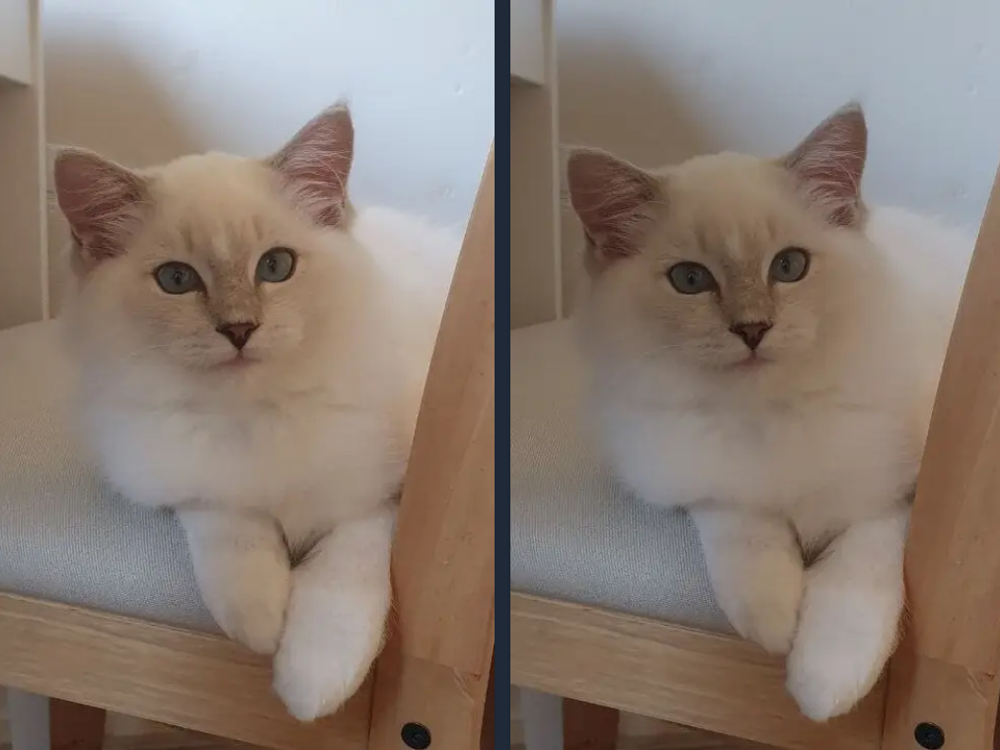

In [18]:
Image("datasets/images/Illumination.png", width="60%")

**class [Illumination](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Illumination) (mode, intensity_range, effect_type, angle_range, center_range, sigma_range, p)**

**mode** - тип освещения.

- **linear** — плавный градиент (как солнечный свет через окно). $\newline$

- **corner** — свет/тень из угла (например, лампа в углу комнаты). $\newline$

- **gaussian** — круговое пятно (как прожектор или фонарик). 

**intensity_range** - задает диапазон интенсивности эффекта. Диапазон значений: $[0.01, 0.2]$

- $0.01–0.05$ — едва заметные изменения.$\newline$

- $0.05–0.1$ — заметное освещение.$\newline$

- $0.1–0.2$ - cильный эффект освещения.

**effect_type** - тип светового эффекта.

- **brighten** – только осветление (как прожектор).$\newline$

- **darken** – только затемнение (как отбрасывание тени).$\newline$

- **both** – случайным образом выбирается между осветлением и затемнением.

**center_range** - диапазон для положения прожектора (только в режиме **'gaussian'**). Значения от 0 до 1, где (0, 0) – верхний левый угол, (1, 1) – нижний правый, (0.5, 0.5) – центр.

**sigma_range** - диапазон размера прожектора (только в режиме **'gaussian'**). Значения от 0.2 до 1. Низкие значения (например, 0.2) дают узкий, сфокусированный световой круг. Более высокие значения (например, 1.0) – создают широкий, мягкий световой эффект.

**p** - вероятность применения трансформации.

# [ImageCompression](https://explore.albumentations.ai/transform/ImageCompression)

Уменьшите качество изображения, применив сжатие JPEG или WebP. Полезно для устойчивости модели к различным качествам изображения.

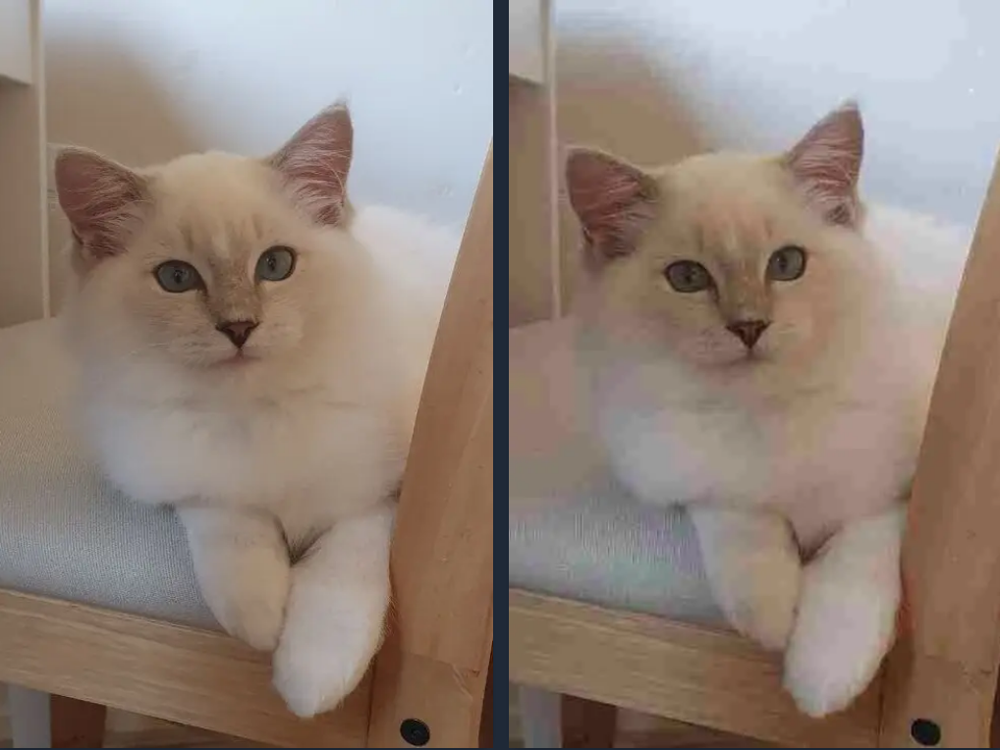

In [19]:
Image("datasets/images/ImageCompression.png", width="60%")

**class [ImageCompression](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ImageCompression) (compression_type = 'jpeg', quality_range = (99, 100), p = 0.5)**

**quality_range** - диапазон качества сжатия. Диапазон значений: $[1, 100]$. (1 - максимальное сжатие, 100 - минимальное сжатие) 

**compression_type** - тип применяемого сжатия: **jpeg** и **webp**.

**p** - вероятность применения трансформации.

# [Downscale](https://explore.albumentations.ai/transform/Downscale)

Уменьшите качество изображения путем уменьшения и увеличения масштаба. Сначала масштаб изображения уменьшается до более низкого разрешения, а затем увеличивается до исходного размера. Может использоваться для имитации изображений низкого качества.

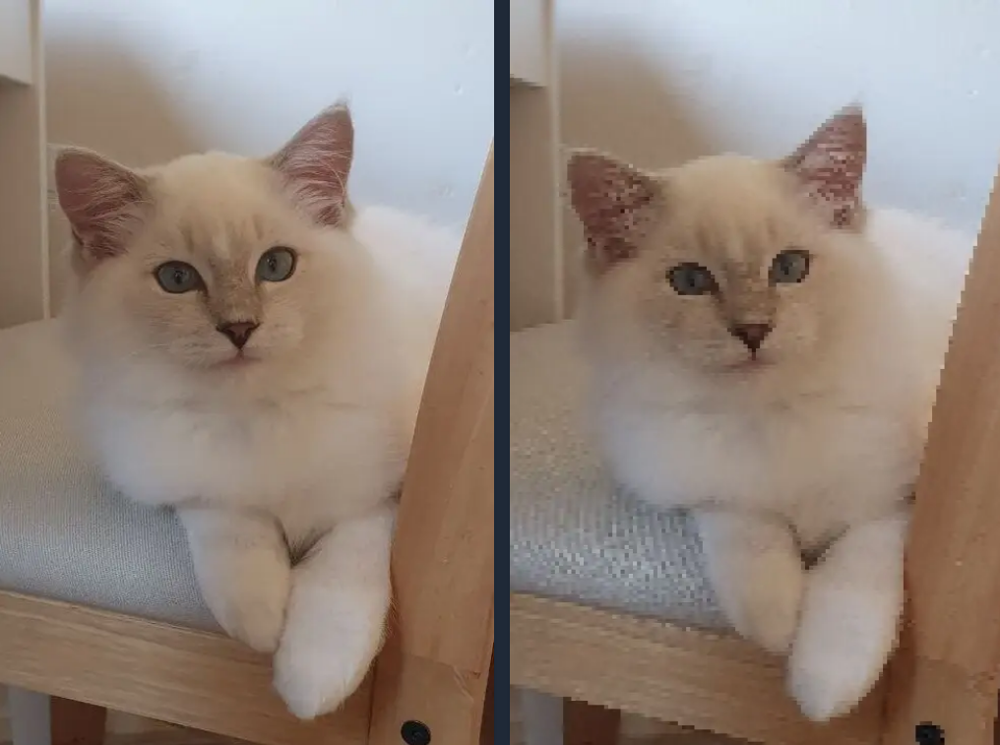

In [20]:
Image("datasets/images/Downscale.png", width="60%")

**class [Downscale](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Downscale) (scale_range=(0.25, 0.25), interpolation_pair={'upscale': 0, 'downscale': 0}, p=0.5)**

**scale_range** - диапазон для коэффициента уменьшения масштаба. Более низкие значения приводят к более агрессивному уменьшению масштаба. Диапазон значений: $[0, 1]$.

**interpolation_pair** - словарь, определяющий методы интерполяции для использования при уменьшении и увеличении масштаба.

**p** - вероятность применения трансформации.

# [Posterize](https://explore.albumentations.ai/transform/Posterize)

Уменьшает количество бит для каждого цветового канала изображения. Применяет технику, которая уменьшает количество отдельных цветов, используемых в изображении.

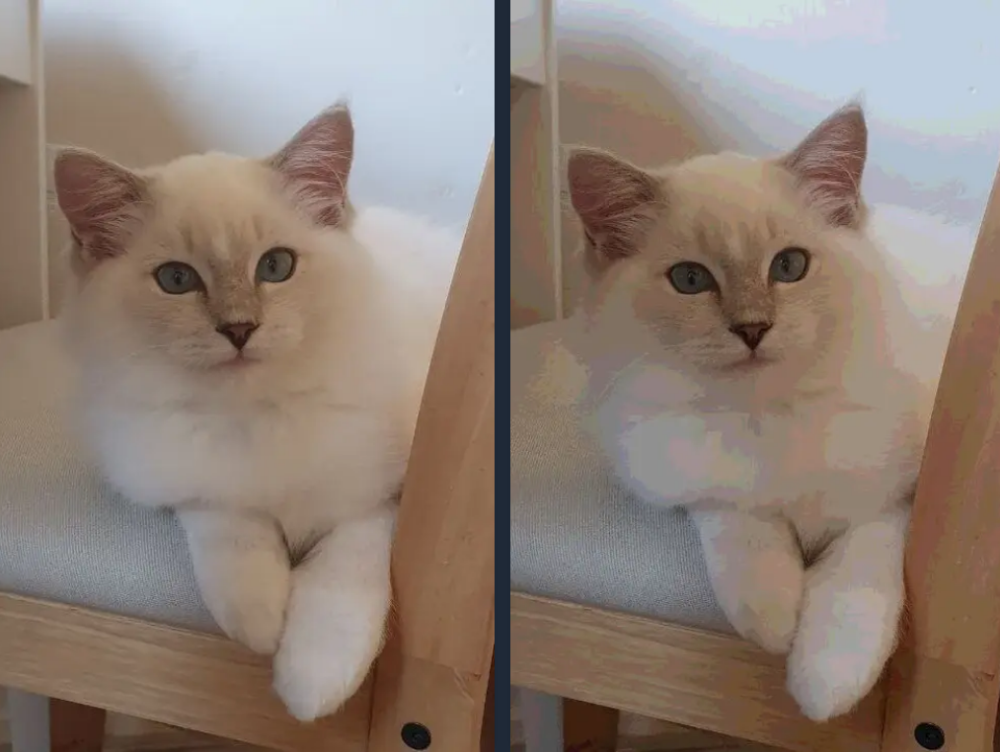

In [21]:
Image("datasets/images/Posterize.png", width="60%")

**class [Posterize](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Posterize) (num_bits=4, p=0.5)**

**num_bits** - определяет количество бит, сохраняемых для каждого цветового канала. Значения: **int** или **tuple[int, int]** - диапазон. 

**p** - вероятность применения трансформации.

# [Emboss](https://explore.albumentations.ai/transform/Emboss)

Создает эффект рельефа, выделяя края и создавая 3D-эффект.

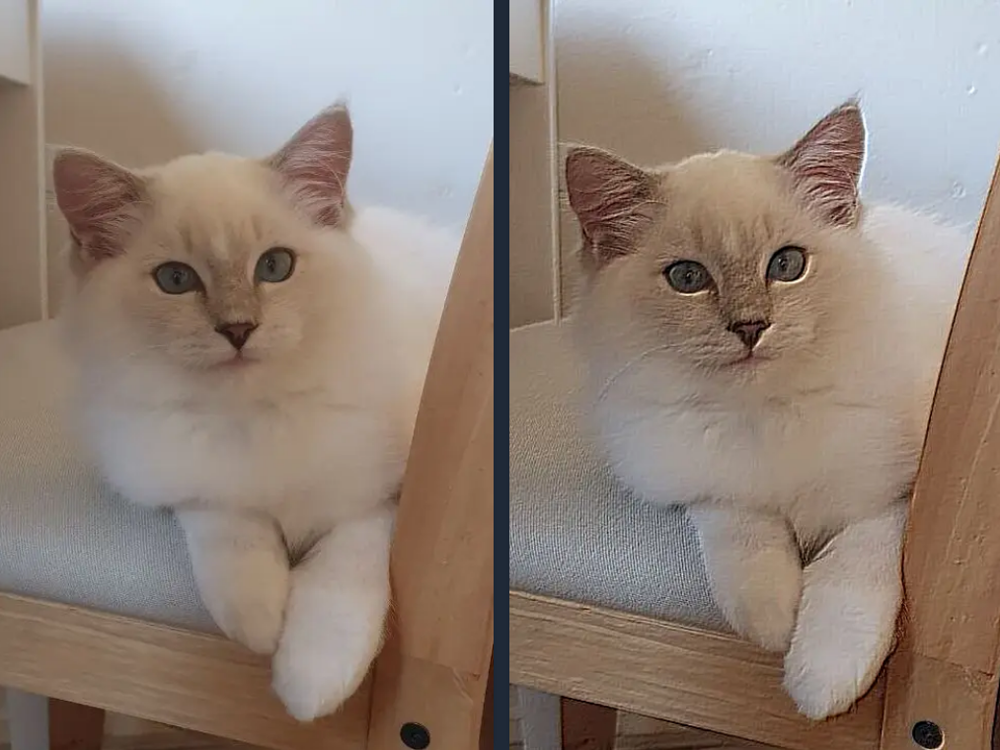

In [23]:
Image("datasets/images/Emboss.png", width="60%")

**class [Emboss](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Emboss) (alpha=(0.2, 0.5), strength=(0.2, 0.7), p=0.5)**

**alpha** - контролирует, насколько сильно будет виден эффект. Диапазон значений: $[0,1]$. (0 - изображение остается неизменным, 1 - видно только эффект тиснения).

**strength** - диапазон для выбора силы эффекта тиснения. Более высокие значения создают более выраженный 3D-эффект. Значения должны быть неотрицательными.

**p** - вероятность применения трансформации.

# [RGBShift](https://explore.albumentations.ai/transform/RGBShift)

Добавляет к каждому каналу **(R, G, B)** константное число, выбранное случайным образом из указанного диапазона. Это похоже на добавление шума, но вместо того чтобы менять яркость случайно для каждого пикселя, он сдвигает все пиксели одного канала на одно и то же значение.

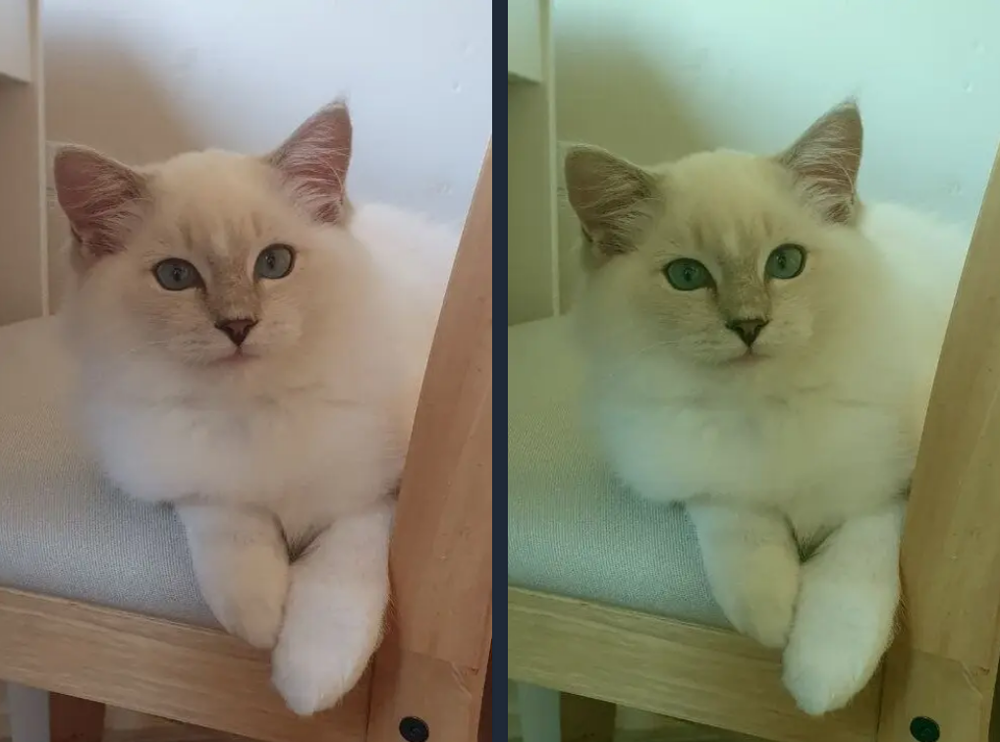

In [24]:
Image("datasets/images/RGBShift.png", width="60%")

**class [RGBShift](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RGBShift) (r_shift_limit = (-20, 20), g_shift_limit = (-20, 20), b_shift_limit = (-20, 20), p = 0.5)**

**r_shift_limit** - диапазон, из которого выбирается случайное значение сдвига для красного канала. Значения представляют абсолютные смещения в диапазоне $[0, 255]$.

**g_shift_limit** - диапазон, из которого выбирается случайное значение сдвига для зеленого канала. Значения представляют абсолютные смещения в диапазоне $[0, 255]$.

**b_shift_limit** - диапазон, из которого выбирается случайное значение сдвига для синего канала. Значения представляют абсолютные смещения в диапазоне $[0, 255]$.

**p** - вероятность применения трансформации.

# [RandomGamma](https://explore.albumentations.ai/transform/RandomGamma)

Применяет нелинейную коррекцию яркости, которая сильнее влияет на средние тона изображения.

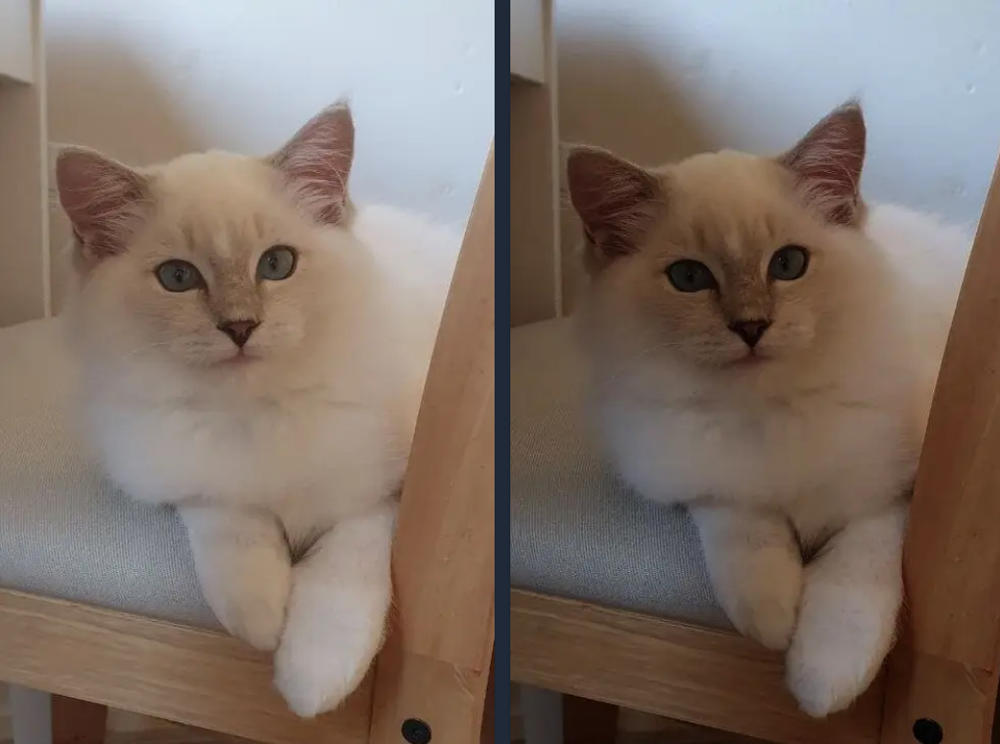

In [25]:
Image("datasets/images/RandomGamma.png", width="60%")

**class [RandomGamma](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomGamma) (gamma_limit=(80, 120), p=0.5)**

**gamma_limit** - нижняя и верхняя границы для регулировки гаммы. Значения указываются в процентах, например, (80, 120) означает, что гамма будет находиться в диапазоне от 80% до 120% от исходного значения. 

**p** - вероятность применения трансформации.

# [RandomRain](https://explore.albumentations.ai/transform/RandomRain)

Добавляет к изображению эффекты дождя. Это преобразование имитирует дождь, накладывая полупрозрачные полосы на изображение, создавая реалистичный эффект дождя. 

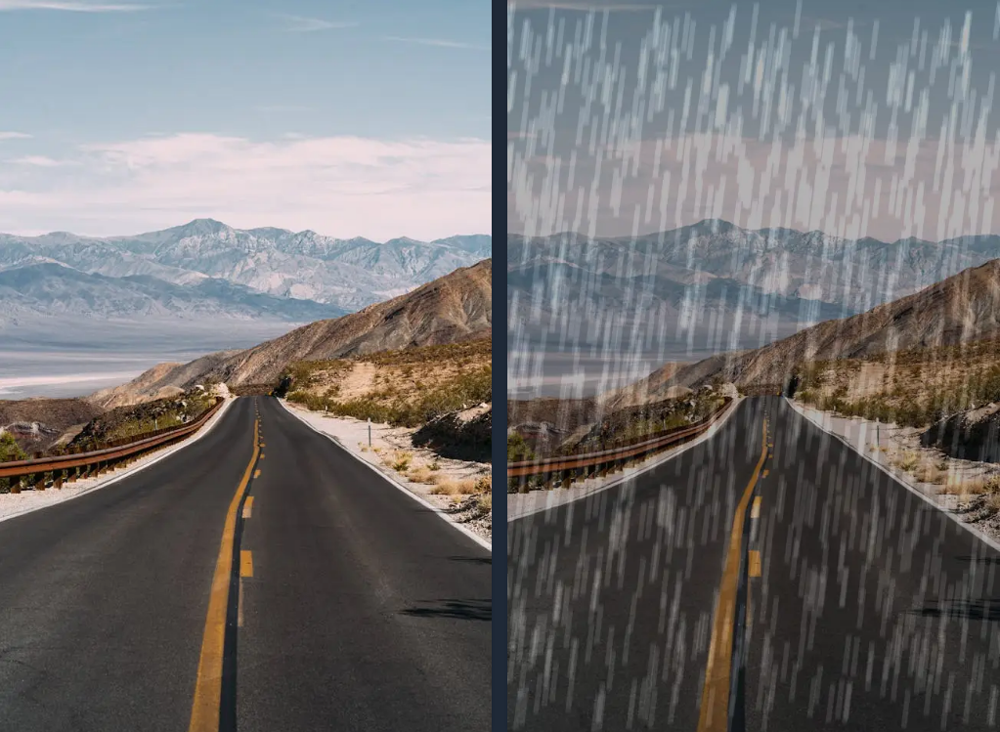

In [26]:
Image("datasets/images/RandomRain.png", width="60%")

**class [RandomRain](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomRain) (slant_range = (-10, 10), drop_length = 20, drop_width = 1, drop_color = (200, 200, 200), blur_value = 7, brightness_coefficient = 0.7, rain_type = 'default', p = 0.5)**

**slant_range** - диапазон угла наклона дождя в градусах.

**drop_length** - длина капель дождя в пикселях.

**drop_width** - ширина капель дождя в пикселях.

**drop_color** - цвет капель дождя в формате RGB. 

**blur_value** - значение размытия для имитации эффекта дождя. Линии должны быть размыты, чтобы более точно имитировать дождь.

**brightness_coefficient** - коэффициент для регулировки яркости изображения. Дождливые сцены обычно темнее. Диапазон значений: $(0, 1]$

**rain_type** - тип дождя для имитации. 

- **drizzle** - моросящий дождь. $\newline$

- **heavy** - сильный дождь. $\newline$

- **torrential** - проливной дождь. $\newline$

- **default** - дождь по умолчанию (такой же, как **drizzle** по ощущуниям).

**p** - вероятность применения трансформации.

# [RandomSnow](https://explore.albumentations.ai/transform/RandomSnow)

Имитирует эффект снега на изображении, либо обесцвечивая некоторые значения пикселей, либо добавляя текстуру снега к изображению, в зависимости от выбранного метода.

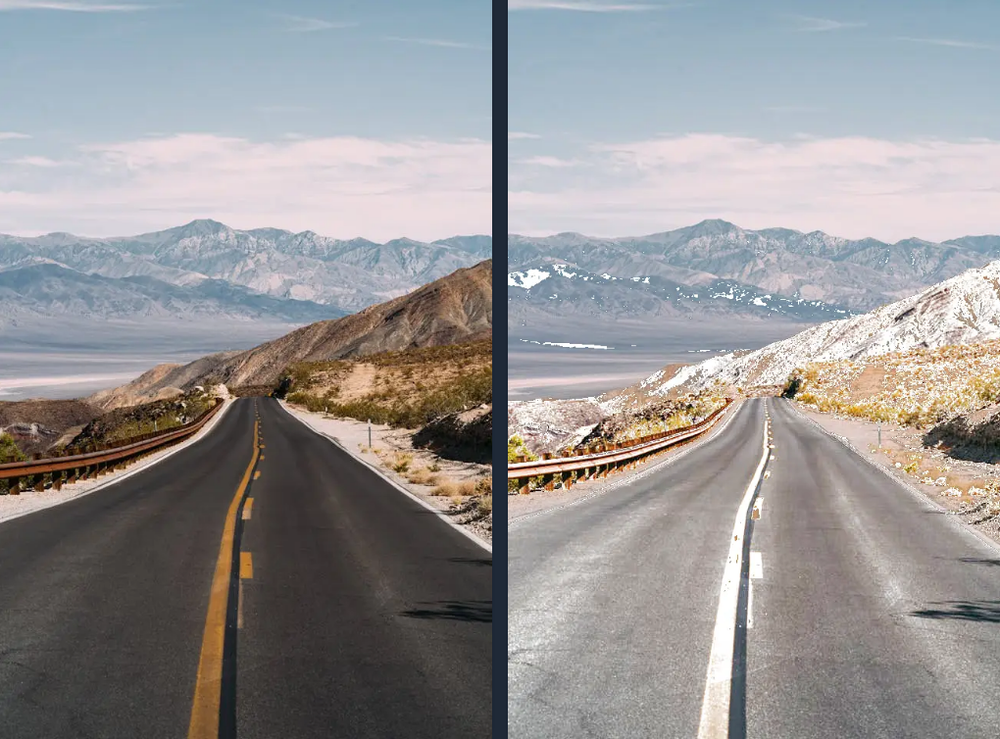

In [27]:
Image("datasets/images/RandomSnow.png", width="60%")

**class [RandomSnow](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomSnow) (brightness_coeff = 2.5, snow_point_range = (0.1, 0.3), method = 'bleach', p = 0.5)** 

**snow_point_range** - диапазон порога точки снега (от 0 до 1). Все пиксели, у которых яркость (меняется от 0 до 1) ниже этого порога, будут умножаться на **brightness_coeff**. 

**brightness_coeff** - коэффициент, применяемый для увеличения яркости пикселей ниже порога **snow_point**.

**method** - метод имитации снега.

- **bleach** - использует технику пороговой обработки пикселей. $\newline$

- **texture** - применяет наложение текстуры снега.

**p** - вероятность применения трансформации.

# [RandomSunFlare](https://explore.albumentations.ai/transform/RandomSunFlare)

Создает эффект солнечного блика путем наложения нескольких полупрозрачных кругов разного размера и интенсивности вдоль линии, исходящей из точки "солнца".

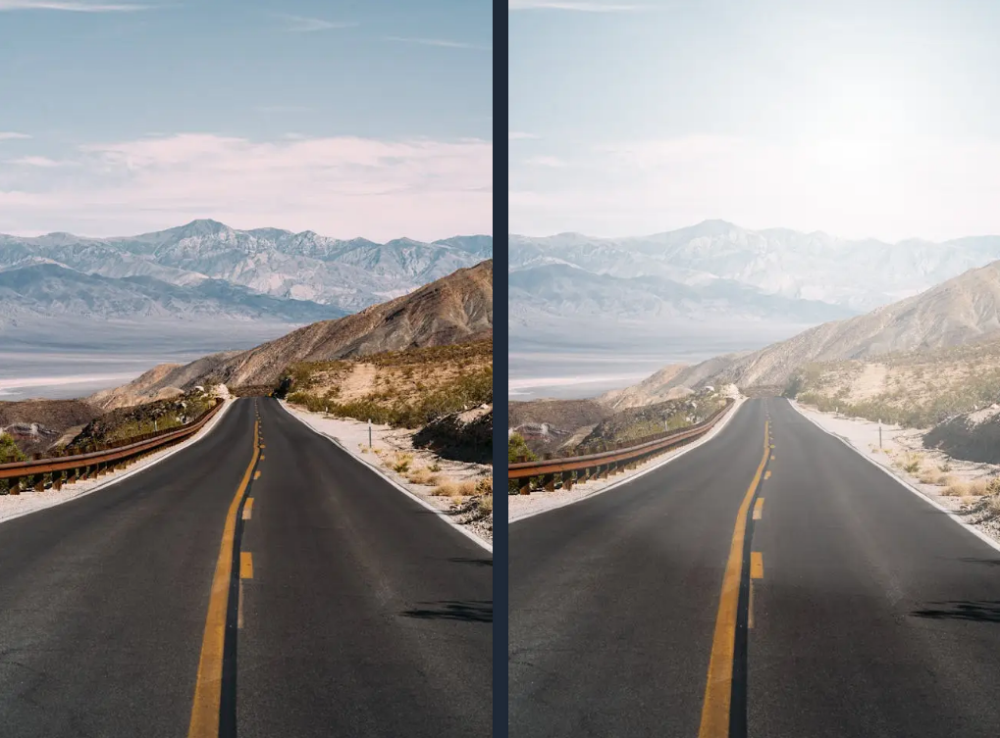

In [28]:
Image("datasets/images/RandomSunFlare.png", width="60%")

**class [RandomSunFlare](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20RandomSunFlare)  ( flare_roi = (0, 0, 1, 0.5), src_radius = 400, src_color = (255, 255, 255), angle_range = (0, 1), num_flare_circles_range = (6, 10), method = 'overlay', p = 0.5 )**

**flare_roi** - область интереса, где может появиться солнечный блик. Значения находятся в диапазоне $[0, 1]$ и представляют $(x\_min, y\_min, x\_max, y\_max)$ в относительных координатах. Считается от верхнего левого угла изображения. Например, **(0, 0, 1, 0.5)** - верхняя половина изображения.

**angle_range** - диапазон углов (в условных единицах, где 0 соответствует 0 радианам, а 1 — 2π радианам) для направления солнечного блика (в каком направлении будут располагаться добавляемые круги).

**num_flare_circles_range** - указывает, сколько отдельных кругов (элементов блика) будет сгенерировано. Диапазон, например, (6, 10) означает, что будет создано от 6 до 10 кругов. Эффект не заметен при **method = "physics_based"**.

**src_radius** - радиус основного (центрального) круга, представляющего солнце, задается в пикселях.

**src_color** - цвет "солнца" в формате **RGB**. По умолчанию (255, 255, 255) — чистый белый.

**method** - метод генерации эффекта.

- **overlay** - используется простой метод, основанный на наложении полупрозрачных кругов. Этот метод проще и быстрее. $\newline$

- **physics_based** - более сложный и реалистичный метод, который симулирует оптические явления (например, дифракцию и отражения), чтобы создать эффект, приближенный к реальным солнечным бликам.

**p** - вероятность применения трансформации.

# [Sharpen](https://explore.albumentations.ai/transform/Sharpen)

Повышает резкость изображения.

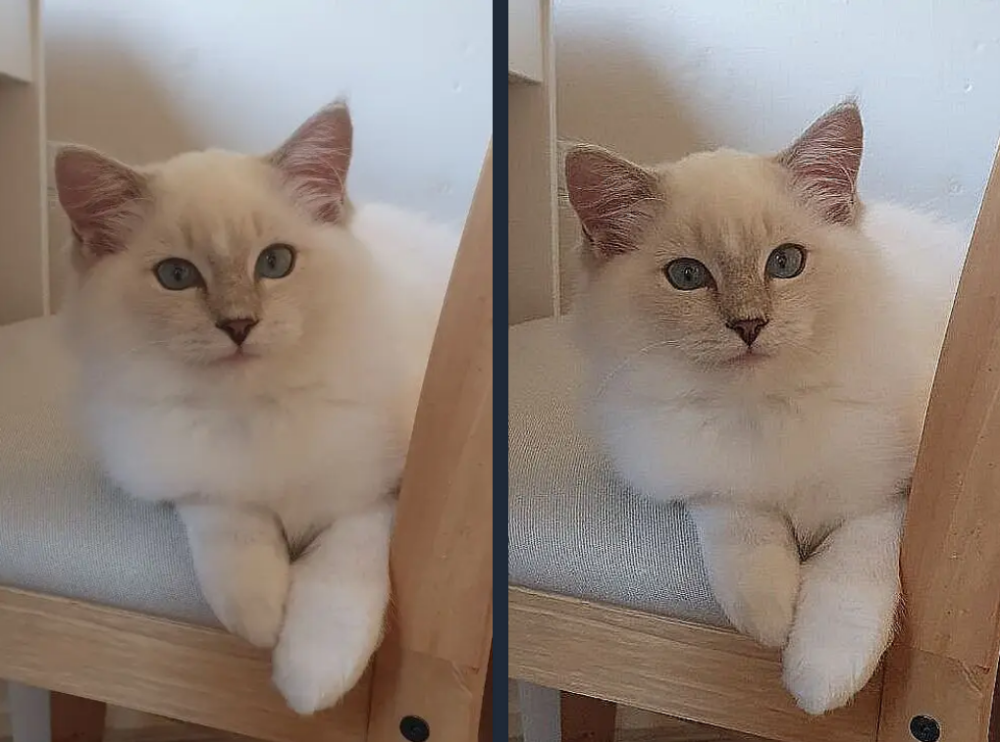

In [29]:
Image("datasets/images/Sharpen.png", width="60%")

**class [Sharpen](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Sharpen) (alpha = (0.2, 0.5), lightness = (0.5, 1.0), method = 'kernel', kernel_size = 5, sigma = 1.0, p = 0.5)**

**alpha** - диапазон видимости эффекта резкости. При значении $0$ видно только исходное изображение, при значении $1$ видна только его обработанная версия. Значения должны быть в диапазоне $[0, 1]$.

**p** - вероятность применения трансформации.

# [Spatter](https://explore.albumentations.ai/transform/Spatter)

Имитирует брызги, которые могут закрывать линзу в виде дождя или грязи.

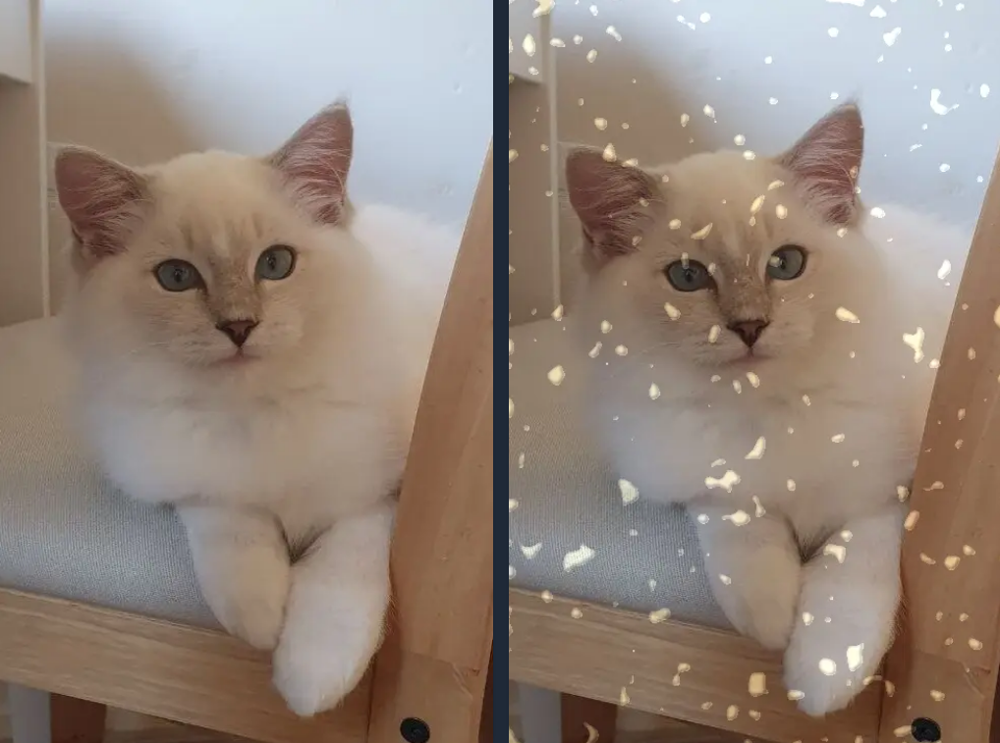

In [30]:
Image("datasets/images/Spatter.png", width="60%")

**class [Spatter](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Spatter) (mean = (0.65, 0.65), std = (0.3, 0.3), gauss_sigma = (2, 2), cutout_threshold = (0.68, 0.68), intensity = (0.6, 0.6), mode = 'rain', color = None, p = 0.5)**

**gauss_sigma** - чем выше значение, тем дальше располагаются и крупнее становятся отдельные элементы эффекта.

**intensity** - интенсивность самого эффекта, то есть, насколько сильно будут видны брызги или капли. Диапазон значении $[0, 1]$. Например, 0 - не видно эффекта. 

**mode** - тип эффекта, который будет имитироваться.

- **rain** -  элементы будут выглядеть как капли дождя, брызги воды. $\newline$

- **mud** - элементы будут выглядеть как капли грязи.

**color** - цвет элементов эффекта.

**p** - вероятность применения трансформации.

# [ToFloat](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20ToFloat)

Делит значения пикселей на **max_value** для получения выходного массива float32, где все значения лежат в диапазоне $[0, 1]$.

In [48]:
A.ToFloat(max_value=255)

ToFloat(p=1.0, max_value=255.0)

# [Normalize](https://albumentations.ai/docs/api_reference/augmentations/transforms/#:~:text=class%20Normalize)

Применяет различные методы нормализации к изображению.

**class Normalize (mean = (0.485, 0.456, 0.406), std = (0.229, 0.224, 0.225), max_pixel_value = 255.0, normalization = 'standard', p = 1.0)**

**mean** - cредние значения для нормализации каждого канала. Используется при **normalization = "standard"**.

**std** - стандартные отклонения для нормализации каждого канала. Используется при **normalization = "standard"**.

**max_pixel_value** - максимальное значение, которое может принимать пиксель.

**normalization** - тип нормализации, который будет применяться.

- **standard** - применяет формулу $\text{img} = \frac{\text{img}\, - \,\text{mean}\, \cdot \,\text{max_pixel_value}}{\text{std} \,\cdot\, \text{max_pixel_value}}$ $\newline$

- **image** - нормализует все изображение на основе его глобального среднего значения и стандартного отклонения. $\newline$

- **image_per_channel** - нормализует изображение по каналам на основе среднего значения и стандартного отклонения каждого канала. $\newline$

- **min_max** - масштабирует значения пикселей изображения до диапазона $[0, 1]$ на основе глобальных минимальных и максимальных значений пикселей.

**p** - вероятность применения трансформации.

In [49]:
A.Normalize()

Normalize(p=1.0, mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=255.0, normalization='standard')